This notebook demonstrates how to use the `RBFScanner` object in `scanners.py` for interactive optimization of support vector classifier (SVC) fitting in scikit-learn. Currently, this approach is limited to optimizing the C and gamma parameters for a Gaussian (or "radial basis function", RBF) kernel, which allows for non-linear decision boundary functions and functions well in the vast majority of cases.

The non-Python details of this process, including a description of the parameters and demonstration of their are consequences, are discussed [here](http://thomasbkahn.github.io/svc-opt).

The mechanics of SVC operation are beyond the scope of this demonstration, but they are described excellently in this [tutorial by Jake VanderPlas](https://www.youtube.com/watch?v=L7R4HUQ-eQ0) (from 1:45:50 to 2:05:30).

# Loading Sample Data

This demonstration will utilize the [famous Iris dataset](https://en.wikipedia.org/wiki/Iris_flower_data_set), which is commonly used in data science and machine learning examples. This dataset consists of measurements of four anatomical features from 50 examples each of three different species of Iris flower. The classification task is to utilize these four measurements to determine which of the three species a sample belongs to.

The dataset is available through scikit-learn (and many other sources).

The Iris data will be loaded into a pandas `DataFrame` object to make use of seaborn plotting functionality, and each of the four features will be scaled independently by computing the Z score. The `DataFrame` is not a required intermediate for SVC optimization, but feature scaling is a *very important* preprocessing step.

In [1]:
# imports
import pandas as pd
from scipy import stats
from sklearn.datasets import load_iris

In [2]:
# load and make Iris DataFrame
iris_data = load_iris()
iris_df   = pd.DataFrame(iris_data['data'], columns=iris_data['feature_names'])
iris_data['target_names'] = [name[0].upper()+name[1:] for name in iris_data['target_names']]
iris_df['species'] = [iris_data['target_names'][target_i] for target_i in iris_data['target']]

# prepare normalized DataFrame
feature_cols = [col for col in iris_df.columns if col.endswith('(cm)')]
norm_df = iris_df.copy()
norm_df[feature_cols] = iris_df[feature_cols].apply(stats.zscore, axis=0)
norm_df.columns = [col.replace('(cm)', 'normalized') for col in norm_df.columns]

# extract data and other necessities
feature_cols = [col for col in norm_df.columns if col.endswith('normalized')]
iris_X = norm_df[feature_cols].values
iris_y = iris_data['target']
iris_class_names = iris_data['target_names']

# Data Visualization

In [3]:
# imports
import warnings
# to prevent harmless warnings raised by matplotlib
warn_msg = (
    "axes.color_cycle is deprecated and replaced "
    "with axes.prop_cycle; please use the latter."
)
warnings.filterwarnings("ignore", message=warn_msg)
import seaborn as sns
%matplotlib inline
sns.set_style({'axes.facecolor':'wheat'})

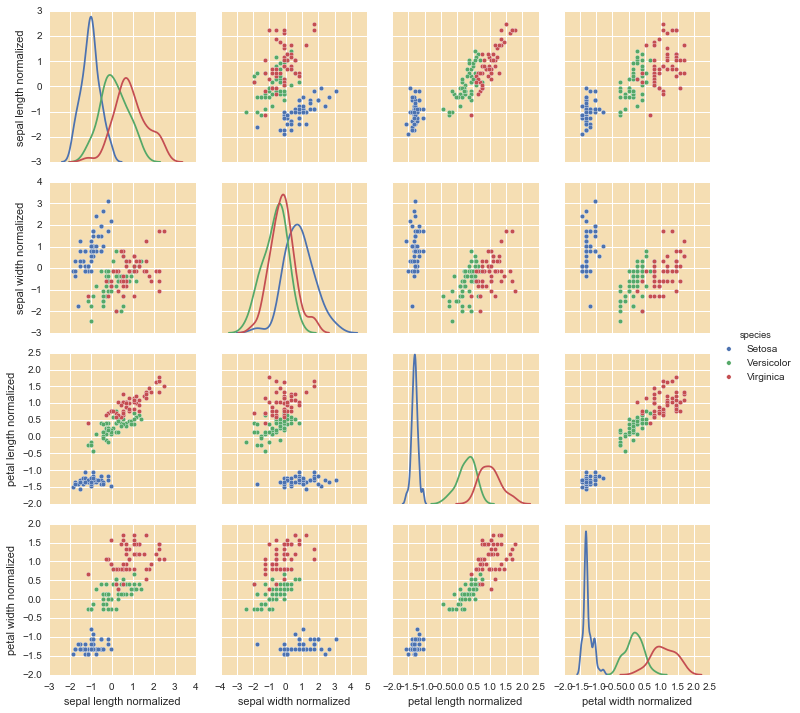

In [4]:
sns.pairplot(norm_df, hue='species', diag_kind='kde');

As seen above, Setosa can easily be separated (even with just the petal-related features), but the separation between Versicolor and Virginica will be a bit trickier.

# `RBFScanner` Objects

Ranges of gamma and C values will be scanned to determine the optimal parameter settings. To accomplish this, the `RBFScanner` object is used, which scans through the parameter values, fits an RBF-kernel support vector classifier using a 0.67/0.33 random train/test splitting of the data (repeated for a specified number of iterations), and stores the weighted-average values of various performance metrics in arrays.

The only required arguments for `RBFScanner` are `X` (input data with n_samples by n_features shape) and `y` (the input labels).

The optional arguments (with their default values) are as follows:
1. `C_lims=(-12,12)`. The range of C values to scan.
2. `gamma_lims=(-12,12)`. The range of gamma values for to scan.
3. `n_steps=50`. The number of steps in the C and gamma ranges.
4. `n_iters=20`. The number of repeats of the train/test splitting and classifier fitting process. Higher values decrease the noise of the results, but cause the scans to take longer.
5. `logvals=True`. Whether the the values of `C_lims` and `gamma_lims` are on a logarithmic scale.
6. `class_names=None`. A list of the names of each class. If not provided, the classes will be referred to as "Class 0", "Class 1", etc.
7. `seed`. Random seed to generate list of 1000 random seeds, each of which will be used to generate list of `n_iters` $\times$ `n_steps` $\times$ `n_steps` seeds for train/test split. This is useful for reproducing results.

In [5]:
# import
from scanners import RBFScanner

In [6]:
# create object (scan will run upon initialization)
# Warning: this will take several minutes for n_iters=60,
# use lower value for faster scans.
iris_scan = RBFScanner(iris_X, iris_y, class_names=iris_class_names, n_iters=60, seed=12)

# Visualizing Results

## Built-in Plotting Methods

To facilitate interactive optimization of parameters, built-in Bokeh plotting methods are provided. These methods are:

- `show_single()`, which shows a plot of a single performance metric.
- `show_train_test()`, which shows the respective accuracies of the training and test data, as well as their difference. This is useful for determining where the classifiers overfit or underfit the data.
- `show_classes()`, which shows the overall performance (*i.e.* accuracy of classification upon the test set), as well as the performance among individual classes (given by the [$F_1$](https://en.wikipedia.org/wiki/F1_score) score for that class).

The three plotting methods are called in a similiar manner, though `show_single()` takes a required `title` argument, which is a string that indicates which of the result matrices is to be demonstrated. Possible options for this value can be found in the `titles` attribute. Additionally, the number of columns to place the plots in the multiple plot methods can be specified with the optional `n_cols` parameter.

All of the plotting methods also have the following additional optional parameters:
1. `dims` : Dimension of the individual Bokeh plot objects (as a (width, height) tuple) in units of pixels.
2. `v_lims` : Limits for the color scale (default is 0.0 to 1.0).
3. `save_string` : If left as default (`None`), the plot will output to the ipython notebook that it was called from. If `return`, the grouped `gridplot` object will be returned (which is useful for inline embedding). If any string that ends with `.html`, the figure will be saved to a file with the corresponding filename.

In [7]:
iris_scan.titles

['Overall Accuracy',
 'Training Accuracy',
 'Difference',
 'Setosa (F1 Score)',
 'Versicolor (F1 Score)',
 'Virginica (F1 Score)']

In [8]:
# try replacing with any value in iris_scan.titles
title = iris_scan.titles[0]

iris_scan.show_single(title)

BokehJS successfully loaded.

By default, values that are identical to the maximum (or are within a set tolerance, given by the `tol` attribute with a default value of 0.001) are highlighted in the plot, and the score result in the tooltip is shown in a distinct color. These colors can be changed by inputting any web color or hexadecimal RGB string to the `plot_params` attribute dictionary, or turned off by entering `None` for either value. The colormap can be changed using the `set_cmap` method, which takes a matplotlib colormap object as input. Defaults can be restored by calling the `restore_plot_defaults` method.

In [9]:
import matplotlib.pyplot as plt

# set colormap to viridis
iris_scan.set_cmap(plt.cm.viridis)

# set highlight color to firebrick
iris_scan.plot_params['highlight_max'] = 'firebrick'

# set tooltip highlighted text to forestgreen
iris_scan.plot_params['highlight_hovertext'] = 'forestgreen'

iris_scan.show_single(title)

BokehJS successfully loaded.

In [10]:
# restore defaults
iris_scan.restore_plot_defaults()

# turn off both plot and text highlighting
iris_scan.plot_params['highlight_hovertext'] = None
iris_scan.plot_params['highlight_max'] = None

# using narrower v_lims to better visualize structure
iris_scan.show_single(title, v_lims=(0.9, 1.0))

BokehJS successfully loaded.

## Overfitting versus Underfitting

In [11]:
iris_scan.restore_plot_defaults()
iris_scan.plot_params['highlight_max'] = None
iris_scan.show_train_test()

BokehJS successfully loaded.

The training accuracy is 1.0 for most cases where gamma is $>0.1$ and C is $>1.0$. However, the overall (test) accuracy is near the baseline value in most of this region, causing the difference signal to be large. This corresponds to overfitting, since the training set is fit perfectly with a model that generalizes poorly to new examples. In the area in which the test accuracy is high, the training accuracy is also correspondingly high (and in fact, slightly higher, as all models will in general perform better on the training set than the test set) leading to a low difference signal. The remaining region of the plots correspond to underfitting, as the resulting classifier models perform poorly for both the training and test sets of data.

## Performance for Individual Classes

In [12]:
iris_scan.restore_plot_defaults()
iris_scan.show_classes()

BokehJS successfully loaded.

The overall performance is largely correlated with the individual performance for Virginica or Versicolor classification, as these two classes were shown to be the most convoluted of the three. Setosa classification is often perfect, which is unsurprising given the distance between that class and the others in the feature-space, as shown above.

## Iteratively Narrowing Parameter Range

To determine more-robust and precise guidelines on the values for C and gamma, the scan can be iterated over an increasingly narrow range of values, increasing the effective resolution. At each step, the performance over the range is evaluated, and the region that reasonably appears to contain a suitable optimum is chosen to determine new limits for the next, smaller scan. (Given the degree of noise in the performance metrics, a more robust method to select the optimum could incorporate polynomial regression on the output metric as a function of input C and gamma values.)

From the above results, it's clear that the classifier performs well almost exclusively in the upper left quadrant. Therefore, the next scan will cover only this region.

In [13]:
# rescan with smaller range
iris_scan.scan(C_lims=(0, 12), gamma_lims=(-12, 0))

In [14]:
# visualize per-class performance, using narrower
# range on v_lims to better illustrate structure
# near maximal values
iris_scan.show_classes(v_lims=(0.9, 1.0))

BokehJS successfully loaded.

The best performing classifiers (in terms of combined overall, Versicolor, and Virginica performances) on average were those with a value of $7.197\times10^{-6}$ for gamma and $4.498\times10^{4}$ for C, with an average overall accuracy of 97.4 % (up from 97.2 %, in the previous scan). The next scan will consider 2 orders of magnitude for each parameter, centered around this point.

In [15]:
iris_scan.scan(C_lims=(3, 5), gamma_lims=(-6, -4))

In [16]:
iris_scan.show_classes(v_lims=(0.9, 1.0))

BokehJS successfully loaded.

The best performing parameters were $1.526\times10^{-5}$ (gamma) and $2.442\times10^{4}$ (C). For the final scan, linear ranges around these values will be used.

In [17]:
iris_scan.scan(C_lims=(2e4, 3e4), gamma_lims=(1e-5, 2e-5), logvals=False)

In [18]:
iris_scan.show_classes(v_lims=(0.9, 0.98))

BokehJS successfully loaded.

The maximum overall accuracy has improved to 97.5 %, and can be reached through several different pairs of C and gamma values within this range. One of these pairs (gamma = $1.245\times10^{-5}$, C = $2.347\times10^{4}$) also maximizes performance in classifying Versicolor and Virginica individually, and thus represents optimal paramater values for future classifier training.